In [3]:
import math
import sympy as sym
import matplotlib.pyplot as plt
import numpy as np
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'
from sympy.abc import beta
from scipy.integrate import quad
from scipy.special import gamma
from sympy import I

from IPython.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))

# Manetic field due to current in a wire plot

In [21]:
def mag_field(lx, ly, lz, xrange, yrange):
    x = np.empty((xrange[1]-xrange[0])*(yrange[1]-yrange[0]))
    y = np.empty((xrange[1]-xrange[0])*(yrange[1]-yrange[0]))
    for i in range(x.size):
        x[i] = (i%(xrange[1]-xrange[0]))+xrange[0]
    c = 0
    d = 0
    for i in range(y.size):
        if c < yrange[1]-yrange[0]:
            y[i] = d + yrange[0]
            c += 1
        if c == yrange[1]-yrange[0]:
            c = 0
            d += 1
    z = np.zeros(y.size)

    I = 1
    mu0 = 1.25663706212e-6

    L = 0
    for i in range(lx.size-1):
        L+= np.sqrt((lx[i+1] - lx[i])**2 + (ly[i+1]- ly[i])**2 + (lz[i+1]- lz[i])**2)
    
    midx, midy, midz = np.zeros(lx.size-1), np.zeros(ly.size-1), np.zeros(lz.size-1)
    dlx, dly, dlz = np.zeros(lx.size-1), np.zeros(ly.size-1), np.zeros(lz.size-1)
    Bx, By, Bz = np.zeros(x.size), np.zeros(y.size), np.zeros(z.size)

    for i in range(x.size):
        rmag = np.empty(lx.size-1)
        xhat, yhat, zhat = np.empty(lx.size-1), np.empty(ly.size-1), np.empty(lz.size-1)
        for j in range(lx.size-1):
            midx[j], midy[j], midz[j] = (lx[j+1]+lx[j])/2, (ly[j+1]+ly[j])/2, (lz[j+1]+lz[j])/2
            dlx[j], dly[j], dlz[j] = (lx[j+1]-lx[j]), (ly[j+1]-ly[j]), (lz[j+1]-lz[j])
        for j in range(lx.size-1):
            rmag[j] = np.sqrt((x[i] - midx[j])**2 + (y[i]- midy[j])**2 + (z[i]- midz[j])**2)
            xhat[j], yhat[j], zhat[j] = (x[i] - midx[j])/rmag[j], (y[i]- midy[j])/rmag[j], (z[i]- midz[j])/rmag[j]
        for j in range(lx.size-1):
            #Bx, By, Bz = (mu0/(4*np.pi))*(np.cross((I/L)*np.array([dlx[j], dly[j], dlz[j]]), np.array([xhat[j], yhat[j], zhat[j]])))/rmag[j]**2
            Bx[i] += (mu0*I/(4*np.pi*L))*(dly[j]*zhat[j]-dlz[j]*yhat[j])/rmag[j]**2
            By[i] += (mu0*I/(4*np.pi*L))*(dlz[j]*xhat[j]-dlx[j]*zhat[j])/rmag[j]**2
            Bz[i] += (mu0*I/(4*np.pi*L))*(dlx[j]*yhat[j]-dly[j]*xhat[j])/rmag[j]**2
    
    return Bx, By, Bz     

/tmp/ipykernel_7457/2864850124.py:36: RuntimeWarning: invalid value encountered in scalar divide
  xhat[j], yhat[j], zhat[j] = (x[i] - midx[j])/rmag[j], (y[i]- midy[j])/rmag[j], (z[i]- midz[j])/rmag[j]


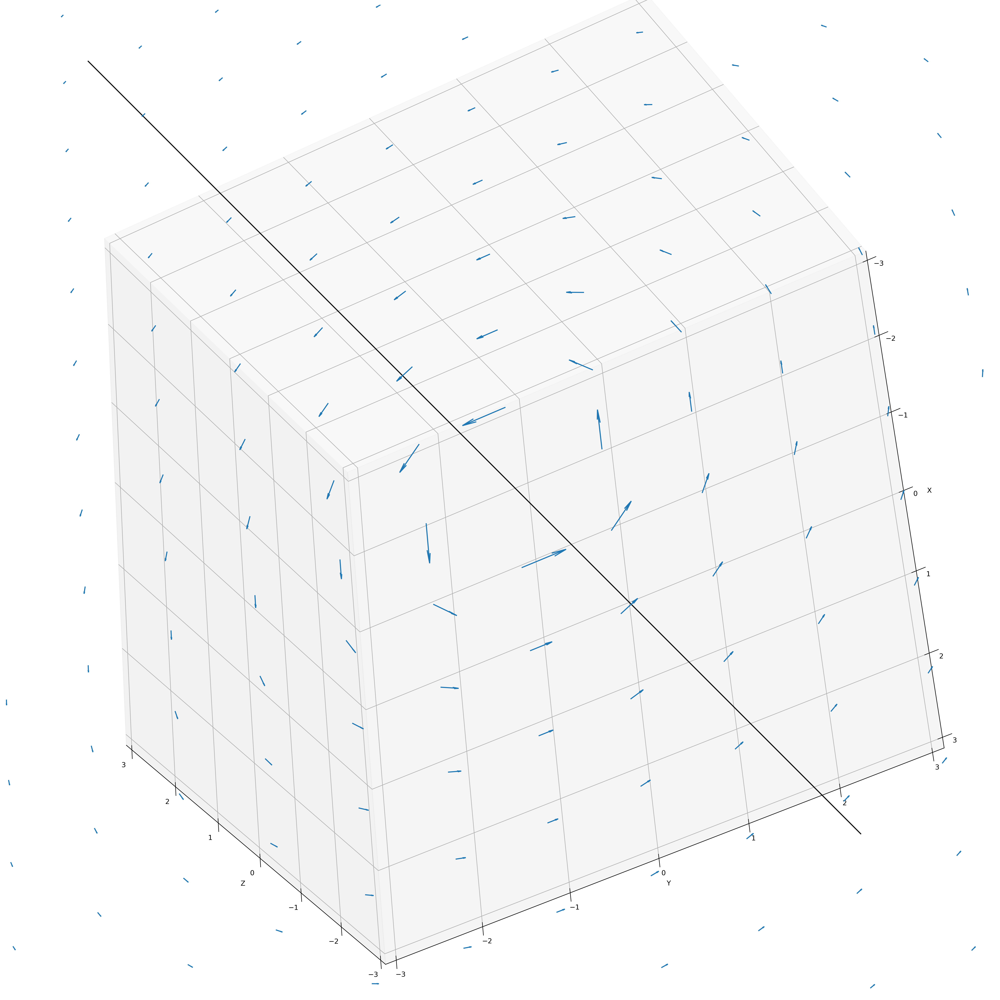

In [150]:
lx, ly, lz = np.linspace(0, 0, 100), np.linspace(0, 0, 100), np.linspace(-10, 10, 100)
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=5e7, normalize=False)
_ = ax.set_xlim(-3, 3), ax.set_ylim(-3, 3), ax.set_zlim(-3, 3)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=45, azim=30, roll=45) 

In [173]:
t = np.linspace(0, 2*np.pi, 100)
lx, ly, lz = t*0, 5*(np.cos(t)), 5*(np.sin(t))
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

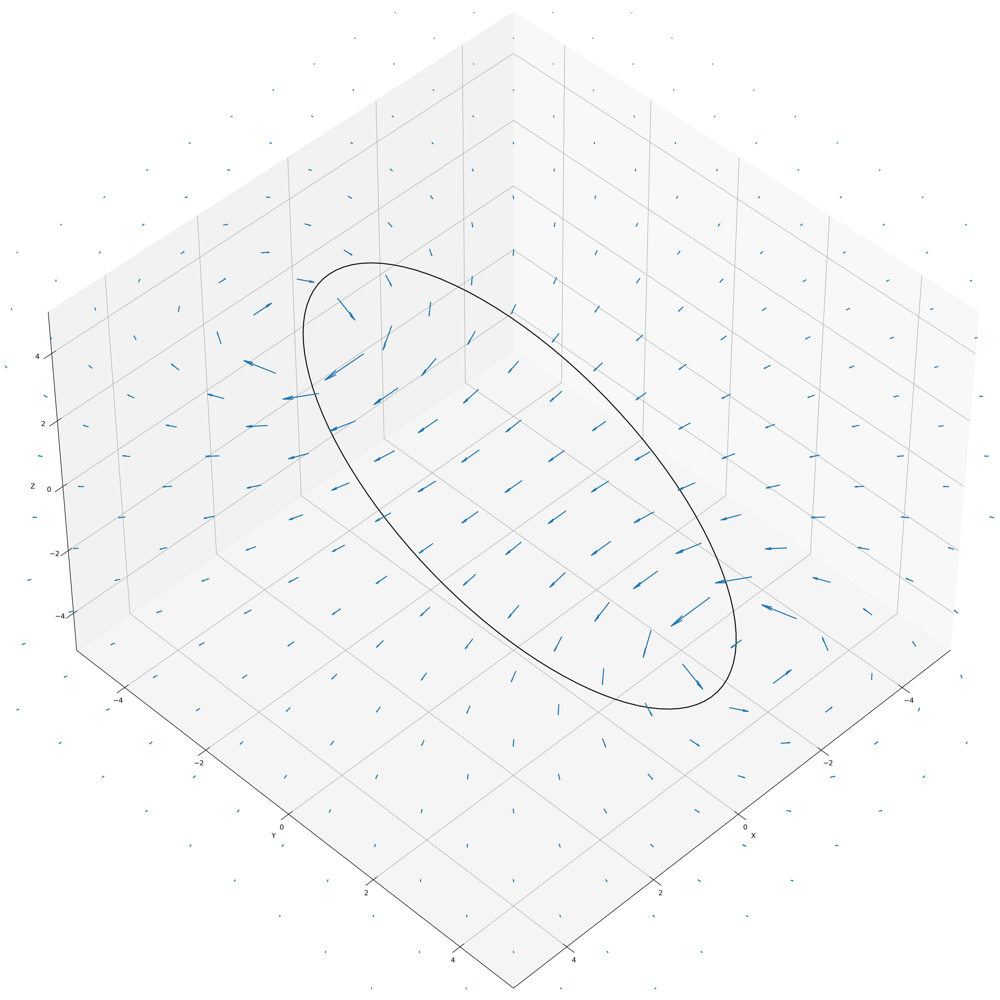

In [175]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=1e8, normalize=False, pivot='middle')
_ = ax.set_xlim(-5, 5), ax.set_ylim(-5, 5), ax.set_zlim(-5, 5)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=45, azim=45, roll=0)

In [160]:
t = np.linspace(0, 2*np.pi, 100)
lx, ly, lz = 5*(np.cos(t)-0.5), 5*(np.sin(t)-0.5), t*0
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

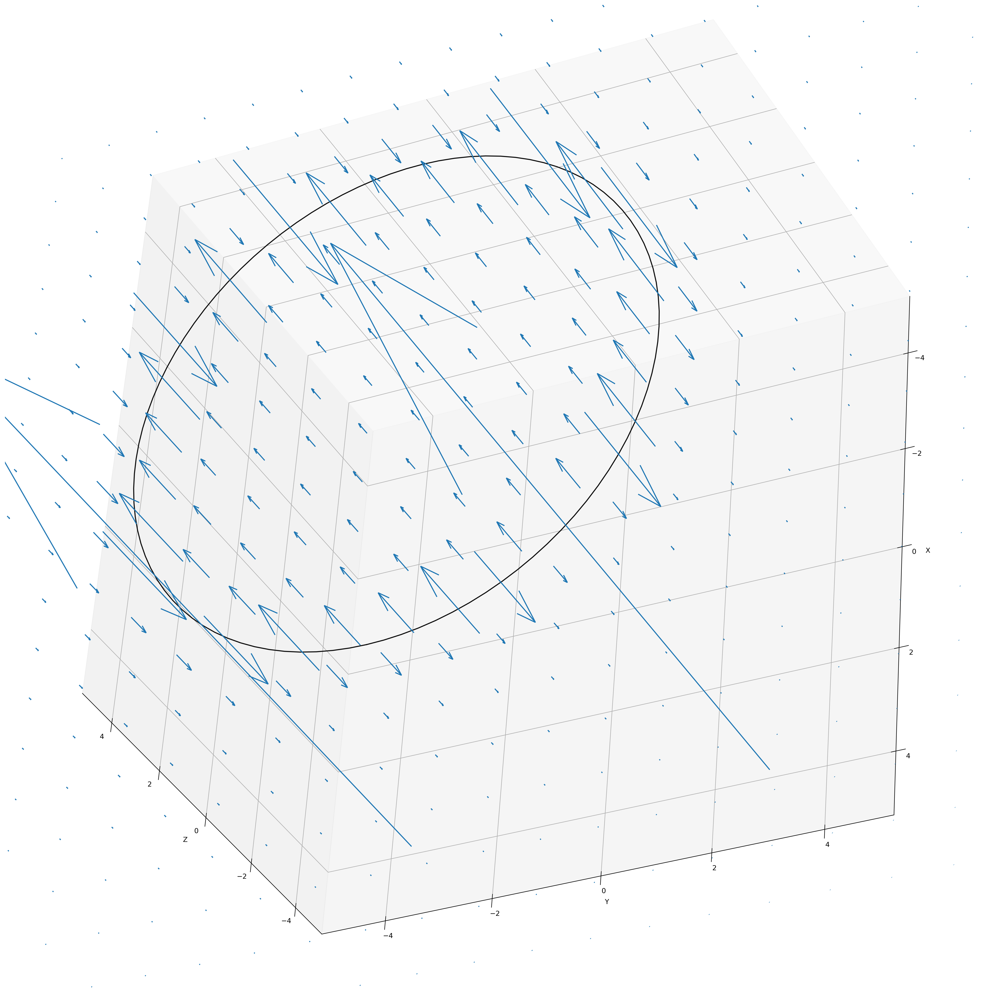

In [161]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=1e8, normalize=False, pivot='middle')
_ = ax.set_xlim(-5, 5), ax.set_ylim(-5, 5), ax.set_zlim(-5, 5)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=45, azim=35, roll=40) 

In [162]:
t = np.linspace(0, 2*np.pi, 100)
lx, ly, lz = 5*(np.cos(t)-0.5), 5*(np.sin(t)-0.5), 5*(t*0+0.5)
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

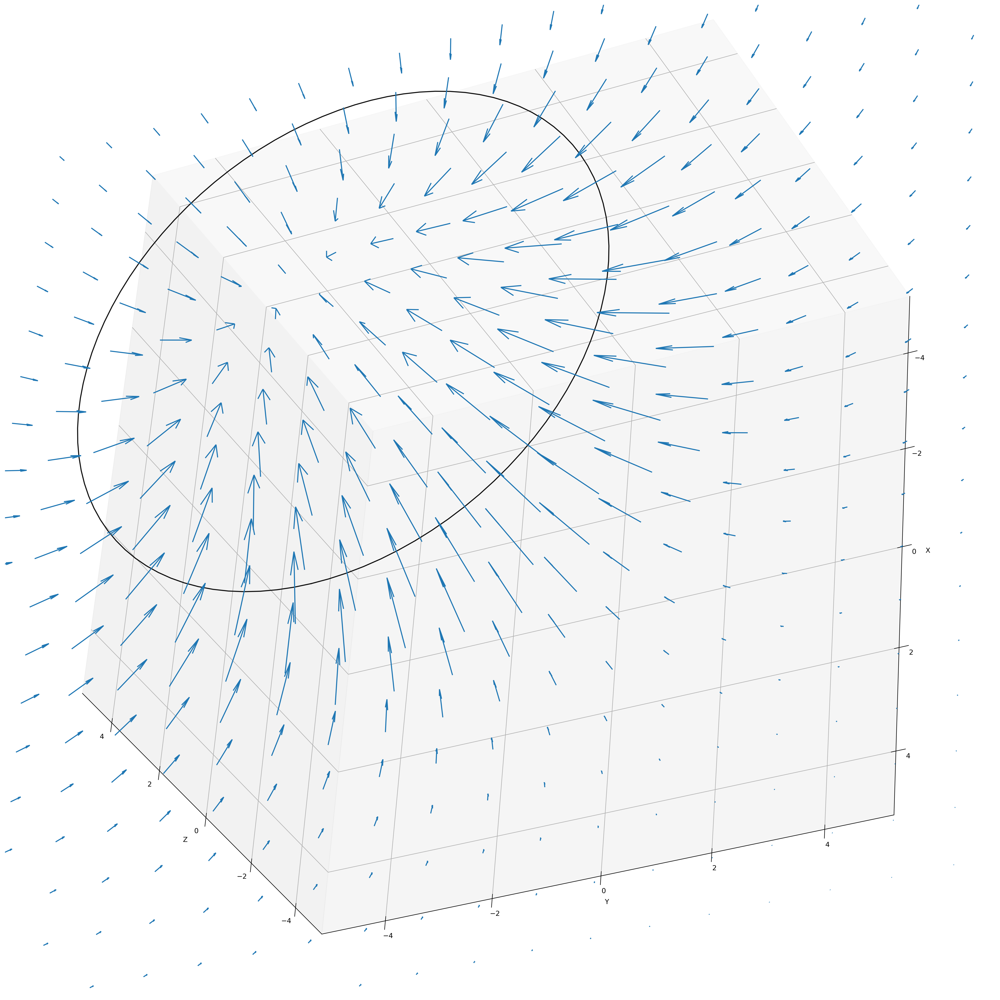

In [163]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=5e8, normalize=False, pivot='middle')
_ = ax.set_xlim(-5, 5), ax.set_ylim(-5, 5), ax.set_zlim(-5, 5)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=45, azim=35, roll=40) 

In [164]:
t = np.linspace(0, 2*np.pi, 500)
lx, ly, lz = 5*(np.cos(t)+0.1*np.cos(20*t)*np.cos(t)-0.5), 5*(np.sin(t)+0.1*np.cos(20*t)*np.sin(t)-0.5), 5*(t*0+0.1*np.sin(20*t))
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

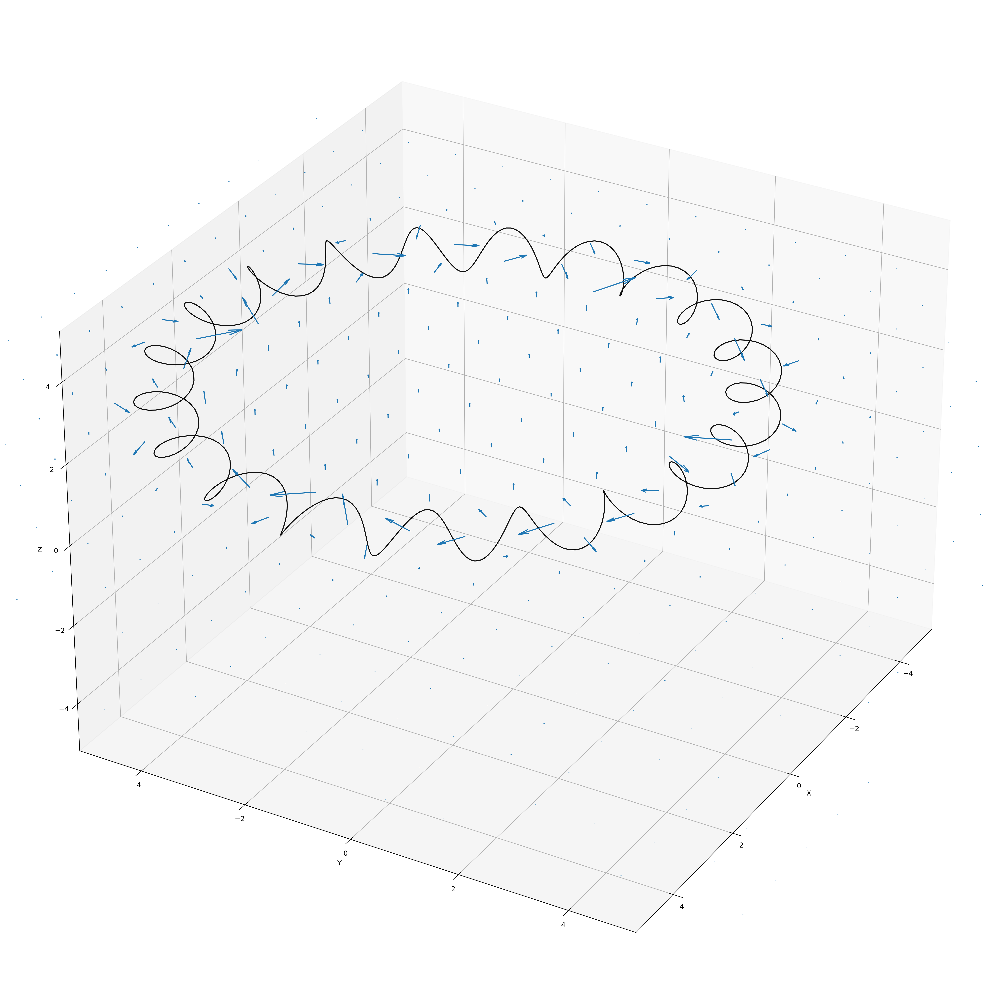

In [165]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=5e7, normalize=False, pivot='middle')
_ = ax.set_xlim(-5, 5), ax.set_ylim(-5, 5), ax.set_zlim(-5, 5)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=30, azim=30, roll=0) 

In [166]:
t = np.linspace(0, 2*np.pi, 500)
lx, ly, lz = 5*(np.cos(t)+0.1*np.cos(20*t)*np.cos(t)-0.5), 5*(np.sin(t)+0.1*np.cos(20*t)*np.sin(t)-0.5), 5*(t*0+0.1*np.sin(20*t)-0.5)
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

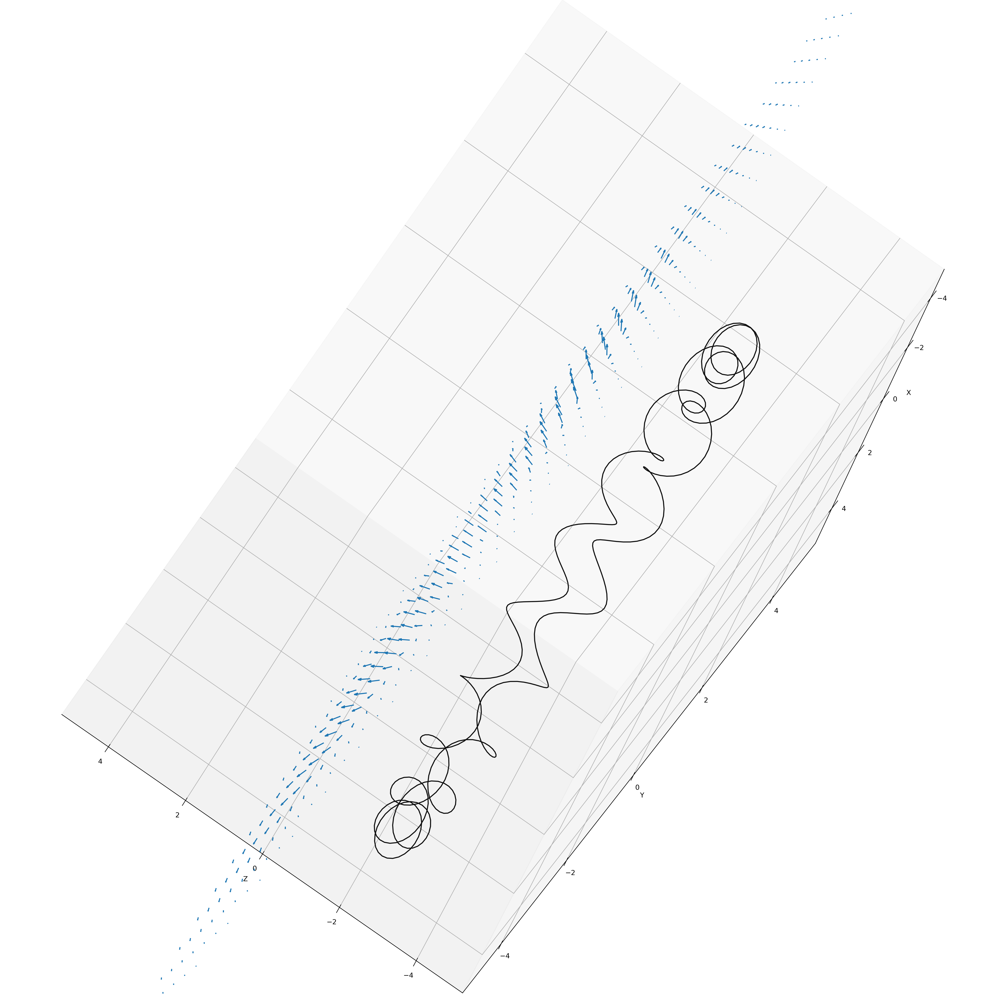

In [167]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=2e8, normalize=False, pivot='middle')
_ = ax.set_xlim(-5, 5), ax.set_ylim(-5, 5), ax.set_zlim(-5, 5)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=2.5, azim=30, roll=55) 

In [168]:
t = np.linspace(0, 2*np.pi, 500)
lx, ly, lz = (np.sin(t)+0.1*np.cos(20*t)*np.sin(t)-0.5)*5, (t*0+0.1*np.sin(20*t))*5, (np.cos(t)+0.1*np.cos(20*t)*np.cos(t)-0.5)*5
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

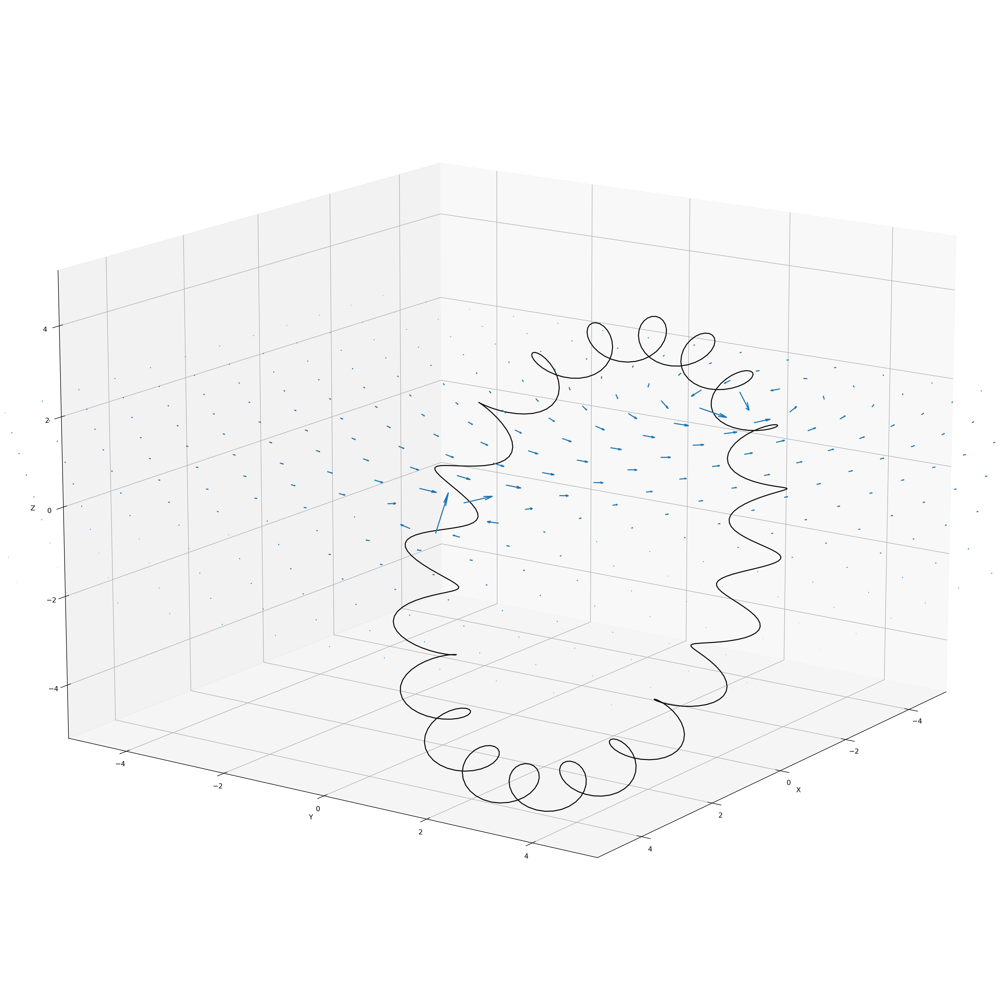

In [169]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=1e8, normalize=False, pivot='middle')
_ = ax.set_xlim(-5, 5), ax.set_ylim(-5, 5), ax.set_zlim(-5, 5)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=15, azim=35, roll=0) 

In [170]:
t = np.linspace(0, 2*np.pi, 500)
lx, ly, lz = (np.sin(t)+0.1*np.cos(20*t)*np.sin(t)+1)*30, (t*0+0.1*np.sin(20*t))*30, (np.cos(t)+0.1*np.cos(20*t)*np.cos(t))*30
xrange = [-10,10]
yrange = [-10,10]
Bx, By, Bz = mag_field(lx, ly, lz, xrange, yrange)

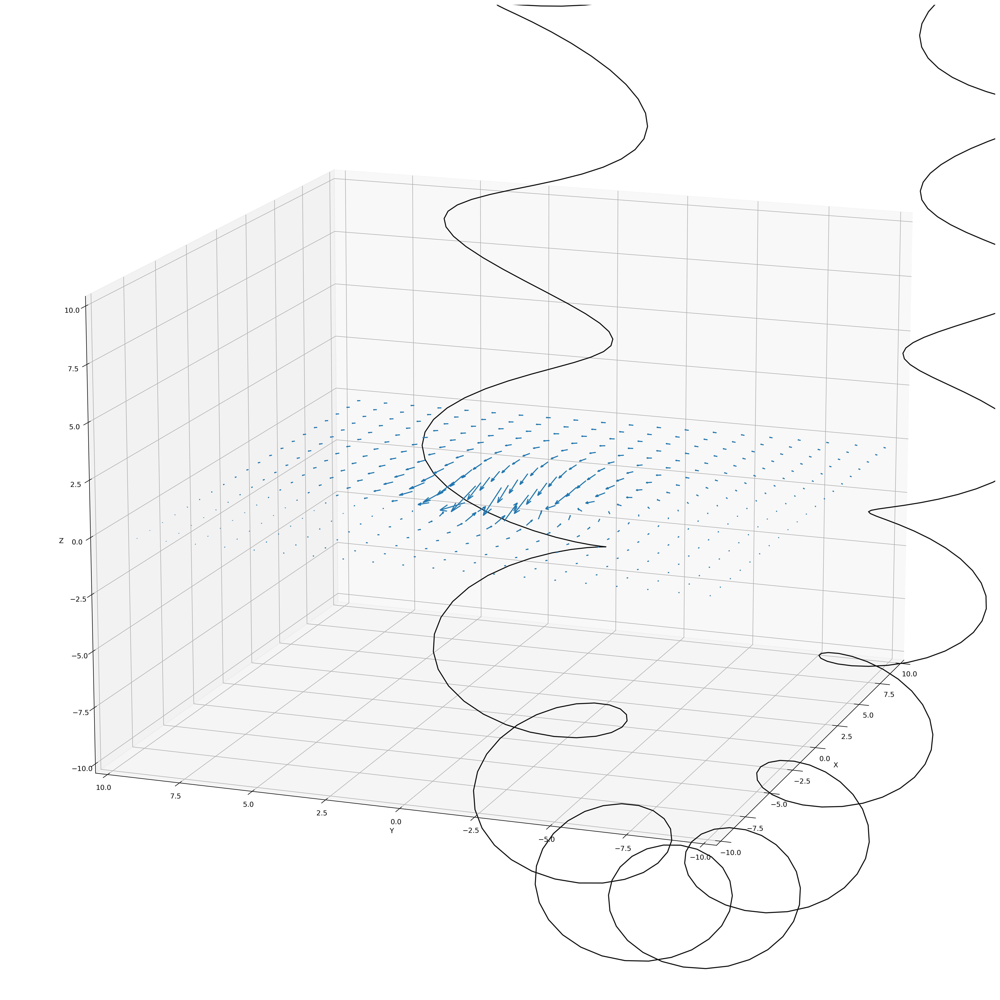

In [171]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=2e9, normalize=False, pivot='middle')
_ = ax.set_xlim(-10, 10), ax.set_ylim(-10, 10), ax.set_zlim(-10, 10)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=15, azim=200, roll=0) 

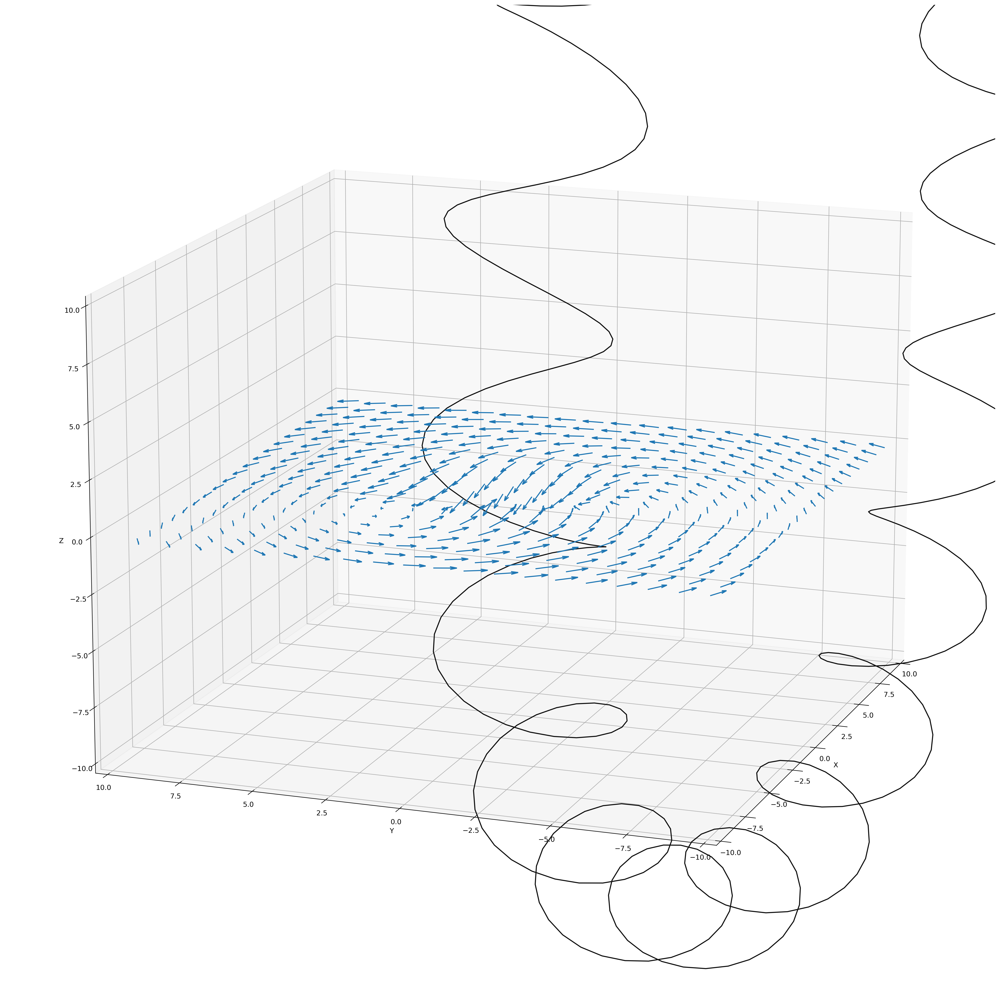

In [172]:
ax = plt.figure(figsize=(20,20), dpi=300, layout="constrained").add_subplot(projection='3d')
ax.plot(lx, ly, lz, color='#101010')
ax.quiver(x, y, z, Bx, By, Bz, length=0.75, normalize=True)
_ = ax.set_xlim(-10, 10), ax.set_ylim(-10, 10), ax.set_zlim(-10, 10)
_ = ax.set_xlabel('X'), ax.set_ylabel('Y'), ax.set_zlabel('Z')
ax.view_init(elev=15, azim=200, roll=0) 